In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import scipy.io
import matplotlib.pyplot as plt
import os
from scipy import signal
from scipy.fft import fft, fftshift

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

file_names=[]
for dirname, _, filenames in os.walk('/content/drive/MyDrive/EEG Data/EEG Data'):
    for filename in filenames:
        file_names.append(os.path.join(dirname, filename))
        #print(os.path.join(dirname, filename))

#print(file_names)
# each trial is about 54 mins


In [ ]:
import numpy as np
from scipy.fft import fft
from sklearn.cluster import KMeans

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
print(file_names)
len(file_names)

['/content/drive/MyDrive/EEG Data/EEG Data/eeg_record1.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record14.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record11.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record13.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record10.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record12.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record22.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record2.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record23.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record19.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record21.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record16.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record24.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record15.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record17.mat', '/content/drive/MyDrive/EEG Data/EEG Data/eeg_record20.mat', '/content/drive/MyDrive/E

34

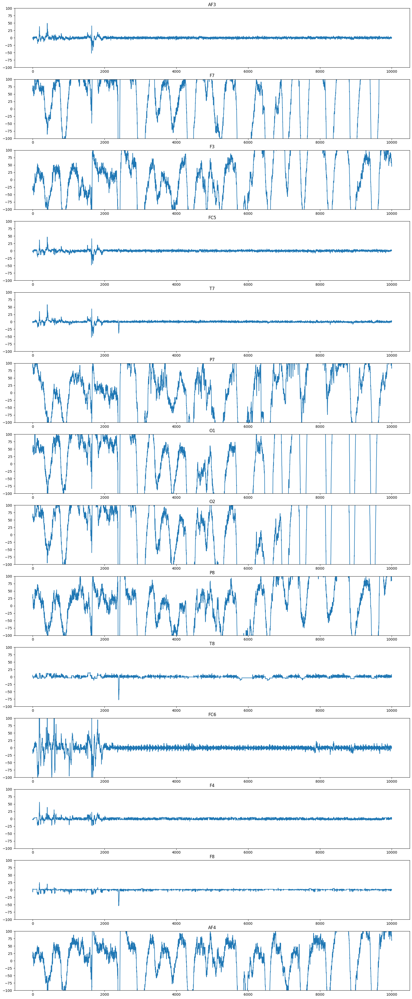

In [ ]:
#starting from Channel 3,/0,1,2,3
# The introduction of the data set in kaggle doesn't provide enough information.
#And we don't know which data are useful I have to plot all the channels.
#There are 14 channels, but the experimenter modified the headset.
#after removing the DC, the EEG amplitude should be around (-100,100).
#According to the plot, I think ['F7','F3','P7','O1','O2','P8','AF4'] are useful channels.
fig, ax = plt.subplots(14,1)
fig.set_figwidth(20)
fig.set_figheight(50)
#fig.set_size_inches(10,10)
mat = scipy.io.loadmat(file_names[0])
data = mat['o']['data'][0,0]
FS = mat['o']['sampFreq'][0][0][0][0]
channels = ['AF3', 'F7', 'F3', 'FC5', 'T7', 'P7', 'O1', 'O2', 'P8', 'T8', 'FC6', 'F4', 'F8', 'AF4']
for i in range(14):
    data_ave = data[5000:15000,i+3]-np.mean(data[5000:15000,i+3])
    ax[i].plot(data_ave)
    ax[i].set_title(channels[i])
    ax[i].set_ylim(-100,100)
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

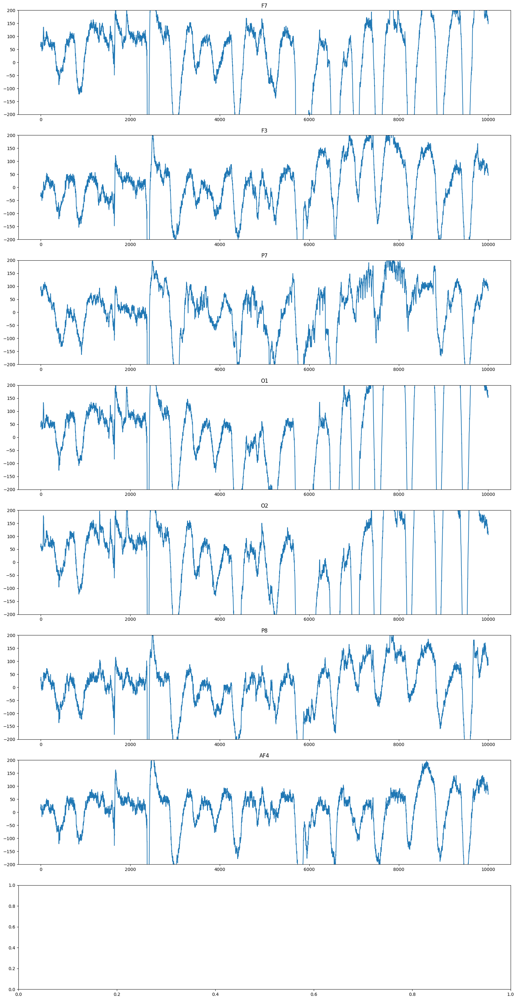

In [ ]:
#F7,F3,P7,O1,O2,P8,AF4
useful_channels=[4,5,8,9,10,11,16]
useful_channels_names=[ 'F7', 'F3', 'P7', 'O1', 'O2', 'P8', 'AF4']
fig,ax = plt.subplots(8)
fig.set_size_inches(20,40)
j=0
for i in useful_channels:
    data_ave = data[5000:15000,i]-np.mean(data[5000:15000,i])
    ax[j].plot(data_ave)
    ax[j].set_ylim(-200,200)
    ax[j].set_title(channels[i-3])
    j=j+1

In [ ]:
marker=128*60*10
#marker here is determinig the 10 minutes interval
#delete file #28 because it doesnot have enough data
useful_file_index = [3,4,5,6,7,10,11,12,13,14,17,18,19,20,21,24,25,26,27,31,32,33,34]
#useful_file_index = np.arange(1,35)
chan_num=7
trail_names=[]
data_focus={}
data_unfocus={}
data_drowsy={}
focus={}
unfocus={}
drowsy={}
#for i in useful_file_index:
i=1
# here after enumerating the fimenames and getting their no in file name say 25 from eeg_record25.mat
#by splitting along the d and the .
# then by specifying the markers we divide the data in 0-10,10-20,20-30 as focused ,unfocused and drowsy state
for index,filename in enumerate(filenames):
    if int(filename.split('d')[1].split('.')[0]) in useful_file_index:
        mat = scipy.io.loadmat(file_names[index])
        trail_names.append(filename.split('.')[0])
        data_focus[trail_names[-1]]=mat['o']['data'][0,0][0:marker,useful_channels].copy()
        data_unfocus[trail_names[-1]]=mat['o']['data'][0,0][marker:2*marker,useful_channels].copy()
        data_drowsy[trail_names[-1]]=mat['o']['data'][0,0][2*marker:3*marker,useful_channels].copy()
        focus[trail_names[-1]]=mat['o']['data'][0,0][0:marker,useful_channels].copy()
        unfocus[trail_names[-1]]=mat['o']['data'][0,0][marker:2*marker,useful_channels].copy()
        drowsy[trail_names[-1]]=mat['o']['data'][0,0][2*marker:3*marker,useful_channels].copy()

In [ ]:
data_drowsy['eeg_record4'].shape

(76800, 7)

In [ ]:
# build 5 order high pass filter
from scipy.signal import butter, lfilter, freqz
# ----- ----- ----- -----
def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def butter_highpass_filter(data, cutoff, fs, order=5):
    b, a = butter_highpass(cutoff, fs, order=order)
    x = signal.filtfilt(b, a, data)
    y = signal.filtfilt(b, a, x)
    return y

In [ ]:
# High Pass 0.16HZ
row, col = data_focus['eeg_record3'].shape
for name in trail_names:
    for i in range(col):
        data_focus[name][:,i]=butter_highpass_filter(data_focus[name][:,i], 0.16, 128, 5)
        data_unfocus[name][:,i]=butter_highpass_filter(data_unfocus[name][:,i], 0.16, 128, 5)
        data_drowsy[name][:,i]=butter_highpass_filter(data_drowsy[name][:,i], 0.16, 128, 5)
        #print(name,data_drowsy[name][:,i].shape)

In [ ]:
data_focus['eeg_record12'].shape

(76800, 7)

In [ ]:
type(data_focus['eeg_record12'])

numpy.ndarray

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


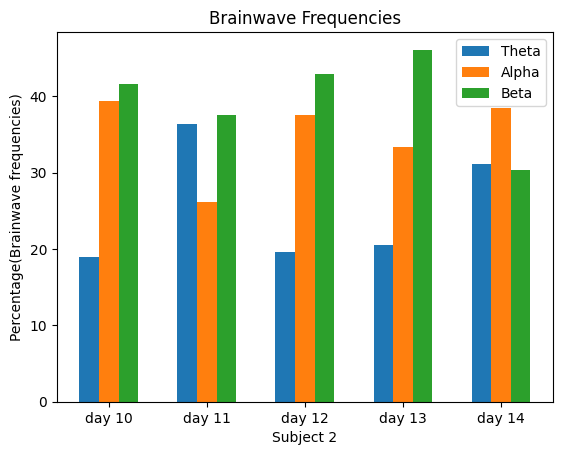

In [ ]:
import numpy as np
from scipy.fft import fft
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Assuming you have a list of 5 preprocessed EEG data samples stored in 'eeg_data'
# 'eeg_data' should be a list of 1D numpy arrays

# Define frequency bands for brainwaves
frequency_bands = {
    'theta': (4, 8),     # Theta band (4 Hz - 8 Hz)
    'alpha': (8, 13),    # Alpha band (8 Hz - 13 Hz)
    'beta': (13, 18),    # Beta band (13 Hz - 18 Hz)
}

# Initialize lists to store brainwave percentages for each iteration
theta_percentages = []
alpha_percentages = []
beta_percentages = []
eeg_data_files=[]

# EEG data file names
for i in range(5):

    eeg_data_files.append('eeg_record'+str(i+10))

# Iterate over each EEG data sample
for i in range(5):
    # Compute power spectral density (PSD) using FFT
    psd = np.abs(fft(data_drowsy[eeg_data_files[i]][:,[2,5]])) ** 2

    # Calculate power for theta, alpha, and beta brainwave frequencies
    theta_power = np.sum(psd[int(frequency_bands['theta'][0]):int(frequency_bands['theta'][1])])
    alpha_power = np.sum(psd[int(frequency_bands['alpha'][0]):int(frequency_bands['alpha'][1])])
    beta_power = np.sum(psd[int(frequency_bands['beta'][0]):int(frequency_bands['beta'][1])])

    # Calculate total power
    total_power = theta_power + alpha_power + beta_power

    # Calculate percentages of theta, alpha, and beta powers
    theta_percentage = (theta_power / total_power) * 100
    alpha_percentage = (alpha_power / total_power) * 100
    beta_percentage = (beta_power / total_power) * 100

    # Append the percentages to the respective lists
    theta_percentages.append(theta_percentage)
    alpha_percentages.append(alpha_percentage)
    beta_percentages.append(beta_percentage)

# Perform K-means clustering on the brainwave percentages
X = np.array(list(zip(theta_percentages, alpha_percentages, beta_percentages)))
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X)

# Plot the brainwave frequencies for each iteration
bar_width = 0.2
index = np.arange(1, 6)

plt.bar(index - bar_width, theta_percentages, width=bar_width, label='Theta')
plt.bar(index, alpha_percentages, width=bar_width, label='Alpha')
plt.bar(index + bar_width, beta_percentages, width=bar_width, label='Beta')

plt.xlabel('Subject 2')
plt.ylabel('Percentage(Brainwave frequencies)')
plt.title('Brainwave Frequencies')

# Set y-axis labels with EEG data file names
plt.xticks(index, [f'day {i+10}' for i in range(5)])

plt.legend()
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


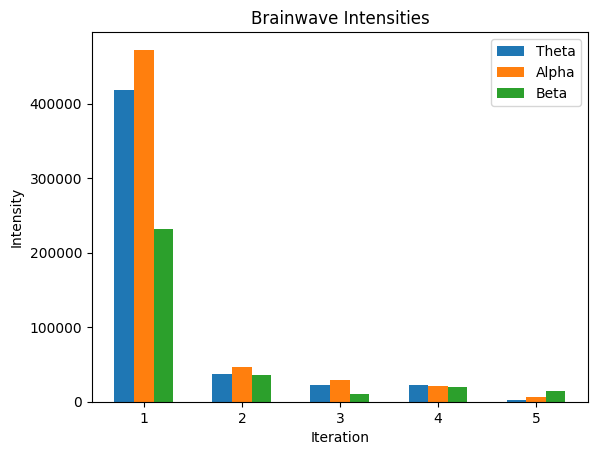

In [ ]:
import numpy as np
from scipy.fft import fft
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans


# 'eeg_data' should be a list of 1D numpy arrays

# Define frequency bands for brainwaves
frequency_bands = {
    'theta': (4, 8),     # Theta band (4 Hz - 8 Hz)
    'alpha': (8, 13),    # Alpha band (8 Hz - 13 Hz)
    'beta': (13, 18),    # Beta band (13 Hz - 18 Hz)
}

# Initialize lists to store brainwave intensities for each cluster
theta_intensities = []
alpha_intensities = []
beta_intensities = []

# Iterate over each EEG data sample
for i in range(5):
    # Compute power spectral density (PSD) using FFT
    psd = np.abs(fft(data_unfocus['eeg_record'+str(i+3)][:,[2,3,4,5,6]])) ** 2

    # Calculate intensity of power for theta, alpha, and beta brainwave frequencies
    theta_intensity = np.sum(psd[int(frequency_bands['theta'][0]):int(frequency_bands['theta'][1])])
    alpha_intensity = np.sum(psd[int(frequency_bands['alpha'][0]):int(frequency_bands['alpha'][1])])
    beta_intensity = np.sum(psd[int(frequency_bands['beta'][0]):int(frequency_bands['beta'][1])])

    # Append the intensities to the respective lists
    theta_intensities.append(theta_intensity)
    alpha_intensities.append(alpha_intensity)
    beta_intensities.append(beta_intensity)

# Perform K-means clustering on the brainwave intensities
X = np.array(list(zip(theta_intensities, alpha_intensities, beta_intensities)))
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X)

# Plot the brainwave intensities for each cluster
bar_width = 0.2
index = np.arange(1, 6)

plt.bar(index - bar_width, theta_intensities, width=bar_width, label='Theta')
plt.bar(index, alpha_intensities, width=bar_width, label='Alpha')
plt.bar(index + bar_width, beta_intensities, width=bar_width, label='Beta')

plt.xlabel('Iteration')
plt.ylabel('Intensity')
plt.title('Brainwave Intensities')
plt.legend()
plt.xticks(index, range(1, 6))
plt.show()


In [ ]:
feature_names = []
freq_range=np.arange(0.5,18.5,0.5)
symb='_'
#useful_channels_names=['F7','F3','P7','O1','O2','P8','AF4']
for index,channel in enumerate(useful_channels_names):
    for freq in freq_range:
        feature_names.append(channel+symb+str(freq))
feature_names

['F7_0.5',
 'F7_1.0',
 'F7_1.5',
 'F7_2.0',
 'F7_2.5',
 'F7_3.0',
 'F7_3.5',
 'F7_4.0',
 'F7_4.5',
 'F7_5.0',
 'F7_5.5',
 'F7_6.0',
 'F7_6.5',
 'F7_7.0',
 'F7_7.5',
 'F7_8.0',
 'F7_8.5',
 'F7_9.0',
 'F7_9.5',
 'F7_10.0',
 'F7_10.5',
 'F7_11.0',
 'F7_11.5',
 'F7_12.0',
 'F7_12.5',
 'F7_13.0',
 'F7_13.5',
 'F7_14.0',
 'F7_14.5',
 'F7_15.0',
 'F7_15.5',
 'F7_16.0',
 'F7_16.5',
 'F7_17.0',
 'F7_17.5',
 'F7_18.0',
 'F3_0.5',
 'F3_1.0',
 'F3_1.5',
 'F3_2.0',
 'F3_2.5',
 'F3_3.0',
 'F3_3.5',
 'F3_4.0',
 'F3_4.5',
 'F3_5.0',
 'F3_5.5',
 'F3_6.0',
 'F3_6.5',
 'F3_7.0',
 'F3_7.5',
 'F3_8.0',
 'F3_8.5',
 'F3_9.0',
 'F3_9.5',
 'F3_10.0',
 'F3_10.5',
 'F3_11.0',
 'F3_11.5',
 'F3_12.0',
 'F3_12.5',
 'F3_13.0',
 'F3_13.5',
 'F3_14.0',
 'F3_14.5',
 'F3_15.0',
 'F3_15.5',
 'F3_16.0',
 'F3_16.5',
 'F3_17.0',
 'F3_17.5',
 'F3_18.0',
 'P7_0.5',
 'P7_1.0',
 'P7_1.5',
 'P7_2.0',
 'P7_2.5',
 'P7_3.0',
 'P7_3.5',
 'P7_4.0',
 'P7_4.5',
 'P7_5.0',
 'P7_5.5',
 'P7_6.0',
 'P7_6.5',
 'P7_7.0',
 'P7_7.5',
 'P7_8.0'

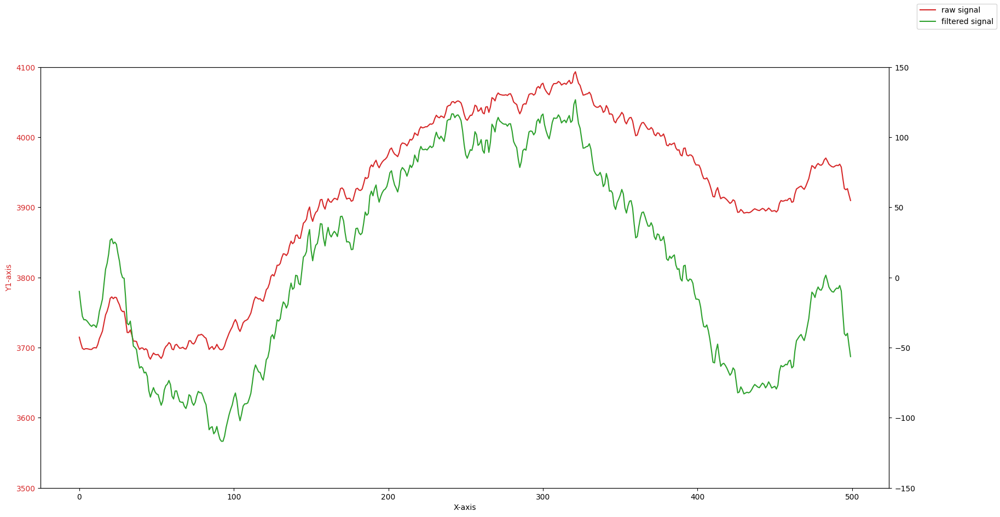

In [ ]:
#validate the high pass filter
fig,ax = plt.subplots(1)
fig.set_size_inches(20,10)
color = 'tab:red'
ax.set_xlabel('X-axis')
ax.set_ylabel('Y1-axis', color = color)
ax.plot(unfocus['eeg_record3'][0:500,0], color = color,label='raw signal')
ax.tick_params(axis ='y', labelcolor = color)
ax.set_ylim(3500,4100)
# Adding Twin Axes to plot using dataset_2
ax0 = ax.twinx()
color = 'tab:green'
ax0.plot(data_unfocus['eeg_record3'][0:500,0],color=color,label='filtered signal')
ax0.set_ylim(-150,150)
fig.legend()
plt.show()

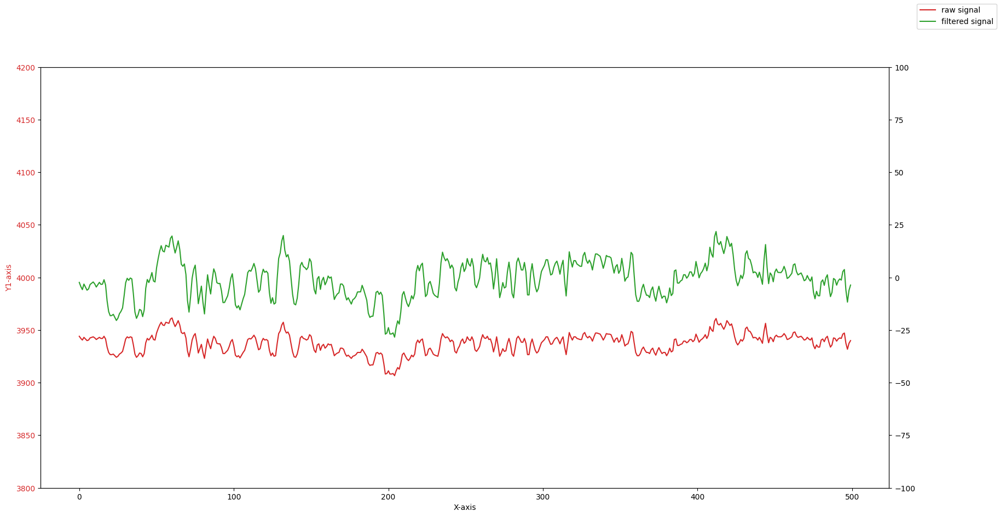

In [ ]:
#validate the high pass filter
fig,ax = plt.subplots(1)
fig.set_size_inches(20,10)
color = 'tab:red'
ax.set_xlabel('X-axis')
ax.set_ylabel('Y1-axis', color = color)
ax.plot(unfocus['eeg_record33'][0:500,0], color = color,label='raw signal')
ax.tick_params(axis ='y', labelcolor = color)
ax.set_ylim(3800,4200)
# Adding Twin Axes to plot using dataset_2
ax0 = ax.twinx()
color = 'tab:green'
ax0.plot(data_unfocus['eeg_record33'][0:500,0],color=color,label='filtered signal')
ax0.set_ylim(-100,100)
fig.legend()
plt.show()

In [ ]:
# STFT was then calculated at a time step of 1 s producing a set of time-varying DFT
# amplitudes X STFT (t,ω) at 1s intervals within each input EEG channel.
t_win = np.arange(0,128)
M = 128
window_blackman=0.42-0.5*np.cos((2*np.pi*t_win)/(M-1))+0.08*np.cos((4*np.pi*t_win)/(M-1))#window_blackman = signal.windows.blackmanharris(128)

#col is 7
power_focus = {}
for name in trail_names:
    power_focus[name]=np.zeros([col,513,601])

power_unfocus = {}
for name in trail_names:
    power_unfocus[name]=np.zeros([col,513,601])

power_drowsy = {}
for name in trail_names:
    power_drowsy[name]=np.zeros([col,513,601])

#the output of the stft is 513*601,1 second data will produce 1 column of data,there are 601
for name in trail_names:
    for i in range(col):
        f, t,y1=scipy.signal.stft(data_focus[name][:,i],fs=128, window=window_blackman, nperseg=128,
                      noverlap=0, nfft=1024, detrend=False,return_onesided=True, boundary='zeros',
                      padded=True)
        f, t,y2=scipy.signal.stft(data_unfocus[name][:,i],fs=128, window=window_blackman, nperseg=128,
                      noverlap=0, nfft=1024, detrend=False,return_onesided=True, boundary='zeros',
                      padded=True)
        f, t,y3=scipy.signal.stft(data_drowsy[name][:,i],fs=128, window=window_blackman, nperseg=128,
                      noverlap=0, nfft=1024, detrend=False,return_onesided=True, boundary='zeros',
                      padded=True)
        power_focus[name][i,:,:]=(np.abs(y1))**2
        power_unfocus[name][i,:,:]=(np.abs(y2))**2
        power_drowsy[name][i,:,:]=(np.abs(y3))**2



In [ ]:
print(power_unfocus['eeg_record3'].shape)

(7, 513, 601)


In [ ]:
print(power_focus['eeg_record3'][1,:,:])

[[8.62180314e+02 1.88581759e+04 2.47465741e+04 ... 5.00748767e+00
  6.21330734e+03 1.15527324e+03]
 [8.58235247e+02 1.86243447e+04 2.44007283e+04 ... 7.35288023e+00
  6.15185008e+03 1.15012455e+03]
 [8.46508401e+02 1.79395263e+04 2.33902155e+04 ... 1.40518368e+01
  5.97089021e+03 1.13482414e+03]
 ...
 [3.64220697e-01 9.24503186e-03 5.64644342e-05 ... 3.52515188e-04
  9.34355783e-04 7.70414492e-02]
 [3.63925977e-01 9.01138790e-03 5.49045496e-05 ... 3.42411665e-04
  9.28262806e-04 7.72490193e-02]
 [3.63826387e-01 8.93225287e-03 5.43422089e-05 ... 3.38993048e-04
  9.26182018e-04 7.73197171e-02]]


In [ ]:
power_focus['eeg_record33'][0,:,:]

array([[7.34679124e+01, 2.38783981e-01, 4.28615024e+00, ...,
        3.20735579e+01, 7.03612124e+00, 1.64971224e-01],
       [7.31282038e+01, 6.22273389e-01, 4.31446066e+00, ...,
        3.19559286e+01, 7.19696646e+00, 1.73102331e-01],
       [7.21178615e+01, 1.73579379e+00, 4.39280687e+00, ...,
        3.16102595e+01, 7.66327052e+00, 1.97148769e-01],
       ...,
       [1.13818388e-02, 8.00625654e-04, 1.55224923e-05, ...,
        2.14525368e-03, 1.93728468e-03, 1.67503288e-04],
       [1.13912648e-02, 8.41483512e-04, 1.39382050e-05, ...,
        2.21459709e-03, 1.95051590e-03, 1.71518888e-04],
       [1.13943577e-02, 8.55482781e-04, 1.34386962e-05, ...,
        2.23831567e-03, 1.95468768e-03, 1.72869820e-04]])

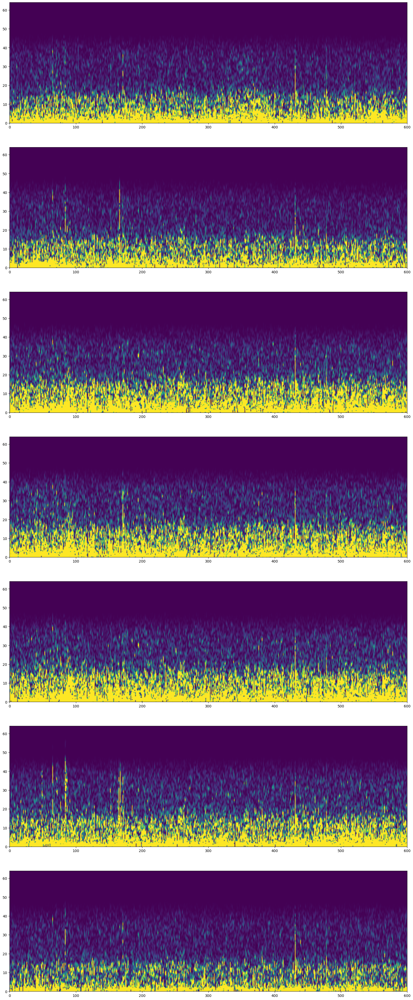

In [ ]:
#validate the power value
fig,ax = plt.subplots(col,1)
fig.set_size_inches(20,50)
for i in range(col):
    ax[i].pcolormesh(t, f, power_focus['eeg_record18'][i,:,:],vmin=0, vmax=2*np.sqrt(2), shading='gouraud')

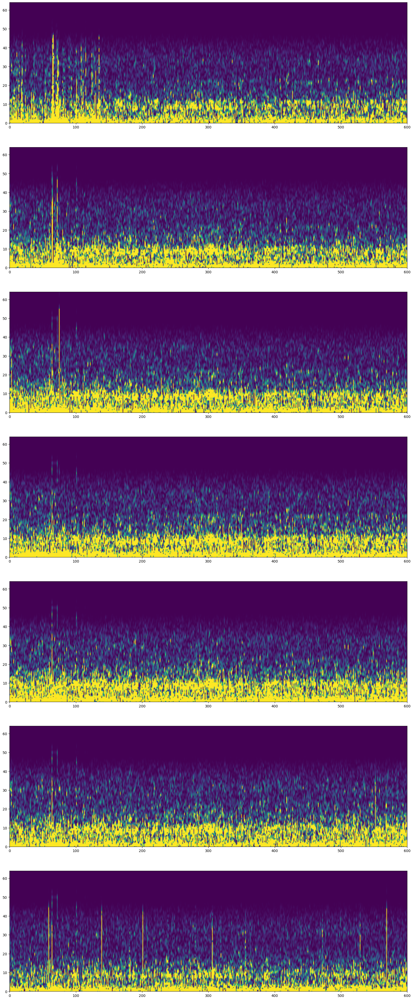

In [ ]:
fig,ax = plt.subplots(col,1)
fig.set_size_inches(20,50)
for i in range(col):
    ax[i].pcolormesh(t, f, power_focus['eeg_record33'][i,:,:],vmin=0, vmax=2*np.sqrt(2), shading='gouraud')

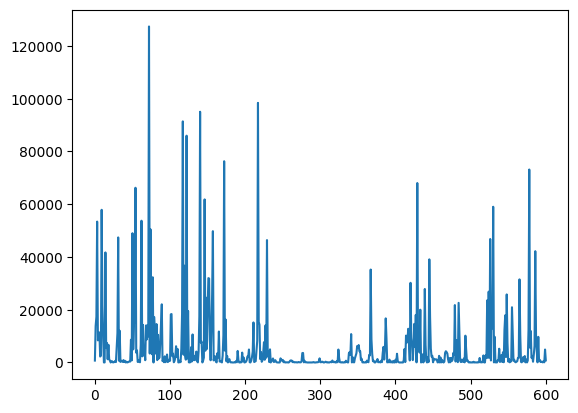

In [ ]:
plt.plot(power_focus['eeg_record3'][2,1,:])

In [ ]:
# combine bins into 0.5HZ, and keep 0-18 HZ.

num=[]

power_focus_bin = {}
for name in trail_names:
    power_focus_bin[name]=np.zeros([7,36,601])

power_unfocus_bin = {}
for name in trail_names:
    power_unfocus_bin[name]=np.zeros([7,36,601])

power_drowsy_bin = {}
for name in trail_names:
    power_drowsy_bin[name]=np.zeros([7,36,601])

for name in trail_names:
    for chn in range(col):
        j=0
        for i in range(1,144,4):
            power_focus_bin[name][chn,j,:]=np.average(power_focus[name][chn,i:i+4,:],axis=0)
            power_unfocus_bin[name][chn,j,:]=np.average(power_unfocus[name][chn,i:i+4,:],axis=0)
            power_drowsy_bin[name][chn,j,:]=np.average(power_drowsy[name][chn,i:i+4,:],axis=0)
            #print(np.average(power_drowsy[name][chn,i:i+4,:],axis=0).shape)
            #if name=='eeg_record3':
            #    if chn==0:
            #        num.append((f[i:i+4]))
            #    print(j)
            j=j+1


#print(num)
#print(len(num))

In [ ]:
# avarage over 15 seconds running window.

power_focus_ave = {}
for name in trail_names:
    power_focus_ave[name]=np.zeros([7,36,585])

power_unfocus_ave = {}
for name in trail_names:
    power_unfocus_ave[name]=np.zeros([7,36,585])

power_drowsy_ave = {}
for name in trail_names:
    power_drowsy_ave[name]=np.zeros([7,36,585])

for name in trail_names:
    for chn in range(col):
        j=0
        for k in range(0,585):
            power_focus_ave[name][chn,:,j]=np.average(power_focus_bin[name][chn,:,k:k+15],axis=1)
            power_unfocus_ave[name][chn,:,j]=np.average(power_unfocus_bin[name][chn,:,k:k+15],axis=1)
            power_drowsy_ave[name][chn,:,j]=np.average(power_drowsy_bin[name][chn,:,k:k+15],axis=1)
            #print(np.average(power_drowsy_bin[name][chn,:,k:k+15],axis=1).shape)
            j=j+1

In [ ]:
len(power_drowsy_ave)


23

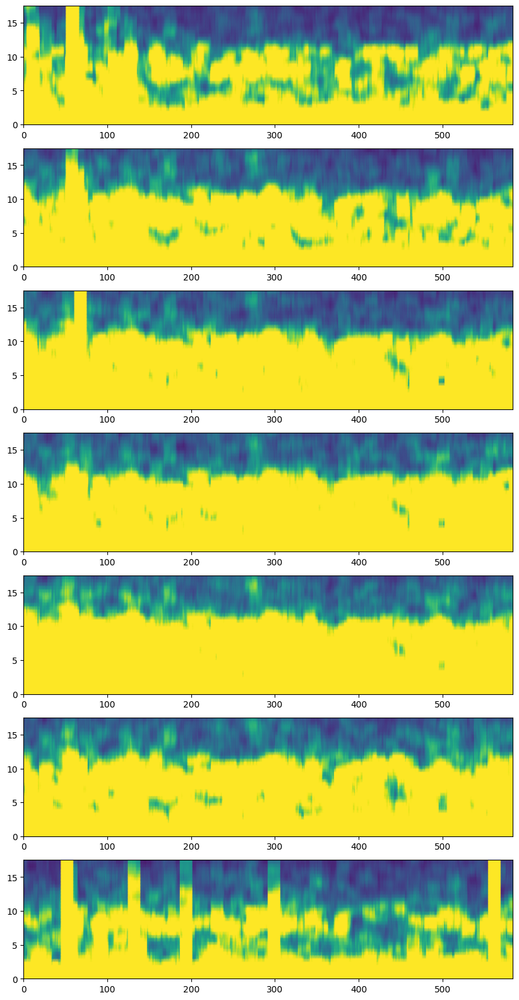

In [ ]:
fig,ax = plt.subplots(col,1)
t1=np.arange(0,585)
f1=np.arange(0,18,0.5)
fig.set_size_inches(10,20)
for i in range(col):
    ax[i].pcolormesh(t1, f1, power_focus_ave['eeg_record33'][i,:,:],vmin=0, vmax=2*np.sqrt(2), shading='gouraud')

In [ ]:
# Turn the data into a vector
#[252,585]

svm_focus = {}
for name in trail_names:
    svm_focus[name]=np.zeros([252,585])

svm_unfocus = {}
for name in trail_names:
    svm_unfocus[name]=np.zeros([252,585])

svm_drowsy = {}
for name in trail_names:
    svm_drowsy[name]=np.zeros([252,585])

for name in trail_names:
    for j in range(585):
        svm_focus[name][:,j]=power_focus_ave[name][:,:,j].reshape(1,-1)
        svm_unfocus[name][:,j]=power_unfocus_ave[name][:,:,j].reshape(1,-1)
        svm_drowsy[name][:,j]=power_drowsy_ave[name][:,:,j].reshape(1,-1)
    svm_focus[name]=10*np.log(svm_focus[name])
    svm_unfocus[name]=10*np.log(svm_unfocus[name])
    svm_drowsy[name]=10*np.log(svm_drowsy[name])
# now, we get the svm vector 252*585 252 rows


In [ ]:
svm_focus['eeg_record33'].shape

(252, 585)

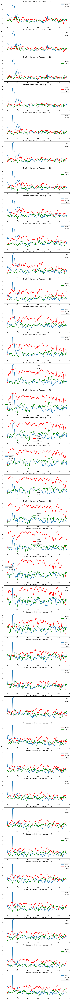

In [ ]:
# along the horizontal direction ,it shows one channel at specific frequecy changes with time.
# each channel has 36 rows of data,
# the following shows 7 channels, each with 36 slots of frequency.
fig,ax = plt.subplots(36,1)
fig.set_size_inches(10,150)
for i in range(36):
    ax[i].plot(svm_focus['eeg_record33'][i,:],label='focus')
    ax[i].plot(svm_drowsy['eeg_record33'][i,:],c='r',label='drowsy')
    ax[i].plot(svm_unfocus['eeg_record33'][i,:],c='green',label='unfocus')
    ax[i].legend()
    ax[i].set_title("The first channel with Frequency at: "+ str((i+1)*0.5) )

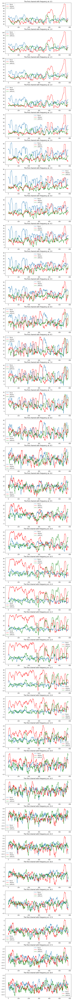

In [ ]:
# along the horizontal direction ,it shows one channel at specific frequecy changes with time.
# each channel has 36 rows of data,
# the following shows 7 channels, each with 36 slots of frequency.
fig,ax = plt.subplots(36,1)
fig.set_size_inches(10,150)
for i in range(36):
    ax[i].plot(svm_focus['eeg_record5'][i,:],label='focus')
    ax[i].plot(svm_drowsy['eeg_record5'][i,:],c='r',label='drowsy')
    ax[i].plot(svm_unfocus['eeg_record5'][i,:],c='green',label='unfocus')
    ax[i].legend()
    ax[i].set_title("The first channel with Frequency at: "+ str((i+1)*0.5) )

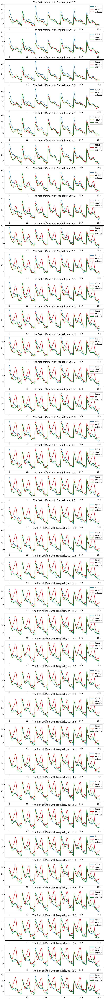

In [ ]:
fig,ax = plt.subplots(36,1)
fig.set_size_inches(10,100)
#at a specific time, each channel changes with frequency
for i in range(36):
    ax[i].plot(svm_focus['eeg_record33'][:,i],label='focus')
    ax[i].plot(svm_drowsy['eeg_record33'][:,i],c='r',label='drowsy')
    ax[i].plot(svm_unfocus['eeg_record33'][:,i],c='green',label='unfocus')
    ax[i].legend()
    ax[i].set_title("The first channel with Frequency at: "+ str((i+1)*0.5) )
# the peak is at the lowest frequency.
#Each peak is the start of the data.

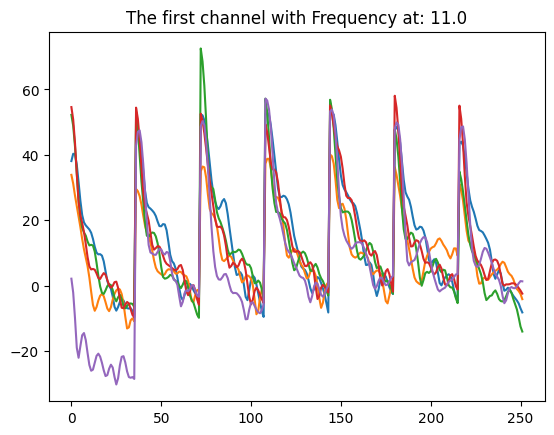

In [ ]:
#at a specific time, each channel changes with frequency
for i in range(0,25,5):
    plt.plot(svm_focus[trail_names[i]][:,1])
# the peak is at the lowest frequency.
#Each peak is the start of the data.
plt.title("The first channel with Frequency at: "+ str((21+1)*0.5))
plt.show()

In [ ]:
#--------0
label_focus = [0]*585
#--------1
label_unfocus = [1]*585
#--------2
label_drowsy = [2]*585

#subject is the variable for all participants

subj1_files={'eeg_record3','eeg_record4','eeg_record5','eeg_record6','eeg_record7'}
subj2_files={'eeg_record10','eeg_record11','eeg_record12','eeg_record13','eeg_record14'}
subj3_files={'eeg_record17','eeg_record18','eeg_record19','eeg_record20','eeg_record21'}
subj4_files={'eeg_record24','eeg_record25','eeg_record26','eeg_record27'}
subj5_files={'eeg_record31','eeg_record32','eeg_record33','eeg_record34'}


In [ ]:
# I will try to use the data from all participants to train the model
target=[]
subj=np.array([]).reshape(252,0).copy()
for name in trail_names:
    subj=np.concatenate((subj,svm_focus[name]), axis=1)
    subj=np.concatenate((subj,svm_unfocus[name]), axis=1)
    subj=np.concatenate((subj,svm_drowsy[name]), axis=1)
    target = target+label_focus+label_unfocus+label_drowsy
subj=subj.T
target = np.array(target)

In [ ]:
subj.shape

(40365, 252)

In [ ]:
# This part I only train the data for subject1
target1=[]
subj1=np.array([]).reshape(252,0).copy()
for name in subj1_files:
    subj1=np.concatenate((subj1,svm_focus[name]), axis=1)
    subj1=np.concatenate((subj1,svm_unfocus[name]), axis=1)
    subj1=np.concatenate((subj1,svm_drowsy[name]), axis=1)
    target1 = target1+label_focus+label_unfocus+label_drowsy
subj1=subj1.T
target1 = np.array(target1)

In [ ]:
print(subj1.shape)
print(len(target1))

(8775, 252)
8775


In [ ]:
target2=[]
subj2=np.array([]).reshape(252,0).copy()
for name in subj2_files:
    subj2=np.concatenate((subj2,svm_focus[name]), axis=1)
    subj2=np.concatenate((subj2,svm_unfocus[name]), axis=1)
    subj2=np.concatenate((subj2,svm_drowsy[name]), axis=1)
    target2 = target2+label_focus+label_unfocus+label_drowsy
subj2=subj2.T
target2 = np.array(target2)


In [ ]:
target3=[]
subj3=np.array([]).reshape(252,0).copy()
for name in subj3_files:
    subj3=np.concatenate((subj3,svm_focus[name]), axis=1)
    subj3=np.concatenate((subj3,svm_unfocus[name]), axis=1)
    subj3=np.concatenate((subj3,svm_drowsy[name]), axis=1)
    target3 = target3+label_focus+label_unfocus+label_drowsy
subj3=subj3.T
target3 = np.array(target3)

In [ ]:
target4=[]
subj4=np.array([]).reshape(252,0).copy()
for name in subj4_files:
    subj4=np.concatenate((subj4,svm_focus[name]), axis=1)
    subj4=np.concatenate((subj4,svm_unfocus[name]), axis=1)
    subj4=np.concatenate((subj4,svm_drowsy[name]), axis=1)
    target4 = target4+label_focus+label_unfocus+label_drowsy
subj4=subj4.T
target4 = np.array(target4)

In [ ]:
target5=[]
subj5=np.array([]).reshape(252,0).copy()
for name in subj5_files:
    subj5=np.concatenate((subj5,svm_focus[name]), axis=1)
    subj5=np.concatenate((subj5,svm_unfocus[name]), axis=1)
    subj5=np.concatenate((subj5,svm_drowsy[name]), axis=1)
    target5 = target5+label_focus+label_unfocus+label_drowsy
subj5=subj5.T
target5 = np.array(target5)

In [ ]:
print('length of the target:',len(target))
print('the shape of the data from the subject1:', subj.shape)

length of the target: 40365
the shape of the data from the subject1: (40365, 252)


In [ ]:
# Train the data from subject1
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.svm import SVC

data_train, data_test, data_train_target, data_test_target = train_test_split(subj5, target5, test_size=0.8, random_state=0)
scaler = preprocessing.StandardScaler().fit(data_train)
X_train_scaled = scaler.transform(data_train)
X_test_scaled = scaler.transform(data_test)

svm = SVC(kernel='rbf')
svm.fit(X_train_scaled,data_train_target)
print(f'The Score for Training data with SVM Model for subject2:',svm.score(X_train_scaled,data_train_target))
print(f'Score of For Test data with SVM Model for subject2 : {svm.score(X_test_scaled,data_test_target)}')

The Score for Training data with SVM Model for subject2: 0.9515669515669516
Score of For Test data with SVM Model for subject2 : 0.9259259259259259


In [ ]:
# Use 60% data for test
from sklearn.decomposition import PCA
data_train, data_test, data_train_target, data_test_target = train_test_split(subj, target, test_size=0.6, random_state=0)
scaler = preprocessing.StandardScaler().fit(data_train)
X_train_scaled = scaler.transform(data_train)
X_test_scaled = scaler.transform(data_test)
#PCA should be used on scaled data
pca = PCA()
pca.fit(X_train_scaled)
X_train_pca = pca.transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
var = pca.explained_variance_/pca.explained_variance_.sum()
var[0:20].sum()

0.9314640344507822

In [ ]:
X_train_scaled.shape

(16146, 252)

In [ ]:
X_train_pca.shape

(16146, 252)

In [ ]:
data_train_target.shape

(16146,)

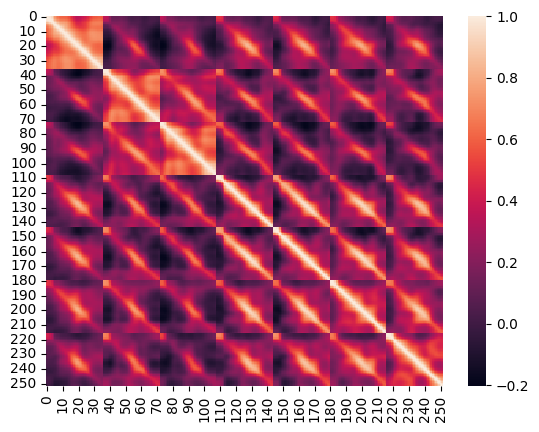

In [ ]:
import seaborn as sns

data_corr = pd.DataFrame(X_train_scaled).corr()
sns.heatmap(data_corr)
plt.show()

In [ ]:
import seaborn as sns
#sns.heatmap(pca.components_)
#print(sum(pca.components_[:,0]**2))

pca_map=pd.DataFrame(pca.components_,columns=feature_names,index=np.arange(1,253))
#pca.components_.shape
pca_map

,F7_0.5,F7_1.0,F7_1.5,F7_2.0,F7_2.5,F7_3.0,F7_3.5,F7_4.0,F7_4.5,F7_5.0,...,AF4_13.5,AF4_14.0,AF4_14.5,AF4_15.0,AF4_15.5,AF4_16.0,AF4_16.5,AF4_17.0,AF4_17.5,AF4_18.0
1,0.028161,0.029186,0.031115,0.034149,0.037915,0.040244,0.042633,0.046087,0.050302,0.054166,...,0.075539,0.071636,0.066099,0.060187,0.055083,0.050551,0.046225,0.042882,0.041681,0.042387
2,0.027448,0.027599,0.026885,0.024117,0.016670,0.007922,0.003572,-0.002953,-0.011915,-0.020435,...,-0.025881,-0.010284,0.008787,0.024398,0.033241,0.037218,0.038602,0.038665,0.037558,0.034968
3,0.110087,0.112291,0.115890,0.120978,0.126484,0.128314,0.129143,0.129258,0.128945,0.129364,...,-0.069994,-0.065053,-0.060144,-0.055660,-0.052422,-0.050919,-0.050226,-0.049443,-0.047999,-0.046108
4,-0.023495,-0.020613,-0.014235,-0.002797,0.015928,0.030765,0.030667,0.028146,0.028583,0.032354,...,-0.061076,-0.072680,-0.080946,-0.087278,-0.094724,-0.102700,-0.109562,-0.114333,-0.115962,-0.114473
5,0.141908,0.143526,0.144779,0.143254,0.133961,0.118108,0.108997,0.100618,0.090343,0.081015,...,0.031569,0.014750,-0.003527,-0.019636,-0.031448,-0.037738,-0.039398,-0.040313,-0.042738,-0.045789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,-0.017438,0.038857,-0.033753,0.017110,-0.006933,0.003674,-0.003764,0.007196,-0.012634,0.016787,...,-0.016905,0.010082,-0.005496,0.003483,-0.002996,0.002217,-0.000693,-0.000723,0.001229,-0.000462
249,-0.005004,0.010996,-0.008548,0.003704,-0.002188,0.002420,-0.002946,0.004352,-0.006234,0.006998,...,-0.034115,0.019017,-0.010868,0.006517,-0.003856,0.001778,0.000143,-0.001313,0.000939,-0.000118
250,-0.005188,0.011897,-0.009014,0.002581,0.000095,0.000097,-0.001700,0.005251,-0.010223,0.013667,...,0.019538,-0.011840,0.008003,-0.006019,0.004658,-0.003350,0.001691,-0.000373,-0.000217,0.000099
251,0.002618,-0.006883,0.006522,-0.002549,0.000249,0.000252,-0.000235,-0.000178,0.001192,-0.002916,...,-0.000344,0.000112,-0.001018,0.002219,-0.003548,0.004197,-0.003616,0.002186,-0.000715,0.000058


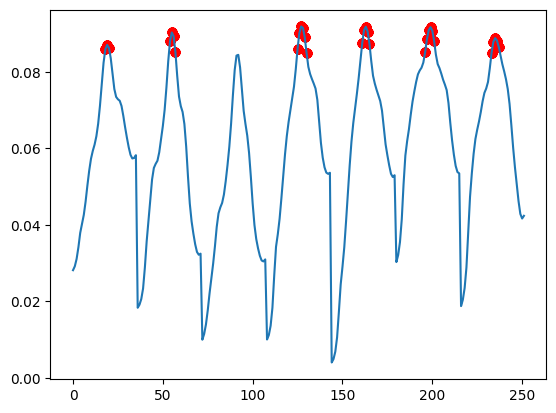

In [ ]:
plt.plot(pca.components_[0,:])
x=np.where(pca.components_[0,:]>0.085)
x=np.array(x)
for i in x[0]:
    plt.scatter(x,pca.components_[0,x],c='r',label=feature_names[i])
#plt.legend()
plt.show()

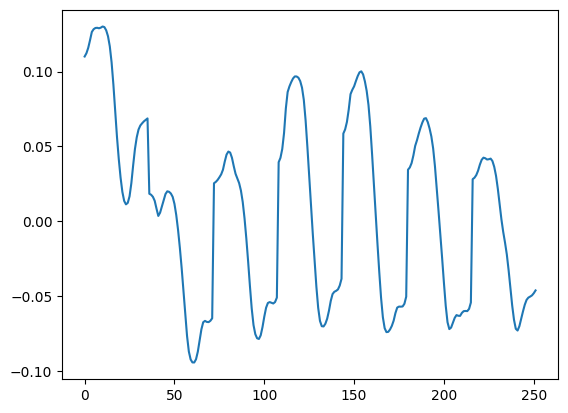

In [ ]:
plt.plot(pca.components_[2,:])

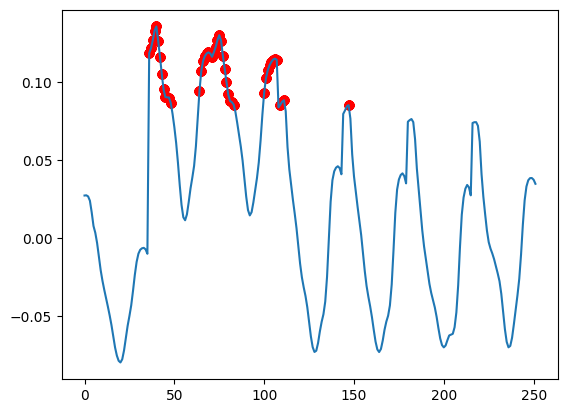

In [ ]:
plt.plot(pca.components_[1,:])
x=np.where(pca.components_[1,:]>0.085)
x=np.array(x)
for i in x[0]:
    plt.scatter(x,pca.components_[1,x],c='r',label=feature_names[i])
#plt.legend()
plt.show()

In [ ]:
#USE SVM linear model
svm = SVC(kernel='linear')
svm.fit(X_train_scaled,data_train_target)
print(f'The Score for Training data with SVM Linear Model for all subjects:',svm.score(X_train_scaled,data_train_target))
print(f'Score of For Test data with SVM Linear Model for all subjects : {svm.score(X_test_scaled,data_test_target)}')

The Score for Training data with SVM Linear Model for all subjects: 0.751207729468599
Score of For Test data with SVM Linear Model for all subjects : 0.7334737189809654


In [ ]:
#Use RBF model
svm = SVC(kernel='rbf')
svm.fit(X_train_scaled,data_train_target)
print(f'The Score for Training data with SVM RBF Model for all subjects:',svm.score(X_train_scaled,data_train_target))
print(f'Score of For Test datawith SVM RBF Model for all subjects : {svm.score(X_test_scaled,data_test_target)}')

The Score for Training data with SVM RBF Model for all subjects: 0.9438870308435526
Score of For Test datawith SVM RBF Model for all subjects : 0.9312936124530328


In [ ]:
svm = SVC(kernel='rbf')
svm.fit(X_train_pca[:,0:30],data_train_target)
print(f'The Score for Training data with SVM RBF Model for all subjects:',svm.score(X_train_pca[:,0:30],data_train_target))
print(f'Score of For Test data with SVM RBF Model for all subjects : {svm.score(X_test_pca[:,0:30],data_test_target)}')

The Score for Training data with SVM RBF Model for all subjects: 0.9179982658243527
Score of For Test data with SVM RBF Model for all subjects : 0.9051571080556587


In [ ]:
#Try KNN Model
from sklearn.neighbors import KNeighborsClassifier
neighbor = KNeighborsClassifier(n_neighbors=3)
neighbor.fit(X_train_scaled,data_train_target)
print("the score for training with data from 5 participants:",neighbor.score(X_train_scaled,data_train_target))
print("the score for test data from 5 participants:",neighbor.score(X_test_scaled,data_test_target))

the score for training with data from 5 participants: 0.9986993682645856
the score for test data from 5 participants: 0.9931045873074859


In [ ]:
neighbor.fit(X_train_pca[:,0:30],data_train_target)
print("the score for training with data from 5 participants:",neighbor.score(X_train_pca[:,0:30],data_train_target))
print("the score for test data from 5 participants:",neighbor.score(X_test_pca[:,0:30],data_test_target))

the score for training with data from 5 participants: 0.99702712746191
the score for test data from 5 participants: 0.9874478715058426


In [ ]:
# decision trees
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(max_depth=16)
dt.fit(X_train_scaled,data_train_target)
print(f"the score for training with data from 5 participants:{dt.score(X_train_scaled,data_train_target)}")
print("the score for test data from 5 participants:",dt.score(X_test_scaled,data_test_target))

the score for training with data from 5 participants:0.9783847392543045
the score for test data from 5 participants: 0.8495809075519221


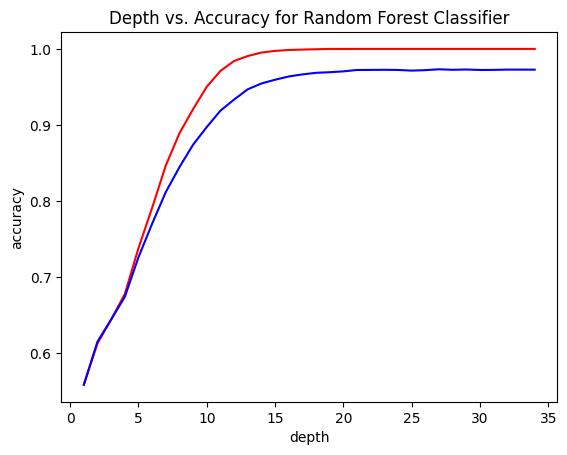

In [ ]:
from sklearn.ensemble import RandomForestClassifier

train_scores = []
test_scores = []
for depth in range(1,35):
    dt_reg = RandomForestClassifier(max_depth=depth,random_state=0)
    dt_reg.fit(X_train_scaled,data_train_target)
    train_scores = train_scores +[dt_reg.score(X_train_scaled,data_train_target)]
    test_scores = test_scores + [dt_reg.score(X_test_scaled,data_test_target)]

x = list(range(1,35))
plt.plot(x,train_scores,c='r',label='train')
plt.plot(x,test_scores,c='b',label='test')
plt.xlabel('depth')
plt.ylabel('accuracy')
plt.title('Depth vs. Accuracy for Random Forest Classifier')
plt.show()

In [ ]:
#from sklearn import tree

# graphviz.Source takes a graphviz object and turns it into an image. Graphviz is a
# standard graphical library/format for rendering graphs - nodes connected by edges -
# such as our decision tree below.
#graphviz.Source(tree.export_graphviz(dt,feature_names=feature_names))
#r=tree.export_text(dt, feature_names=feature_names)
#print(r)

In [ ]:
from sklearn.model_selection import KFold
import tensorflow as tf
tf.random.set_seed(0)
kfold = KFold(n_splits=5, shuffle=True)

data_train_target=data_train_target

fold_no = 1

score_tr=[]
score_cv=[]

svm = SVC(kernel='rbf')

for train,cv in kfold.split(X_train_scaled,data_train_target):
    X_tr = X_train_scaled[train]
    Y_tr = data_train_target[train]
    X_cv = X_train_scaled[cv]
    Y_cv = data_train_target[cv]

    tf.random.set_seed(0)

    svm.fit(X_tr,Y_tr)
    score_tr.append(svm.score(X_tr,Y_tr))
    score_cv.append(svm.score(X_cv,Y_cv))

    print(f'Score for {fold_no} Fold Training: {score_tr[-1]:.3f}')
    print(f'Score for {fold_no} Fold cv    : {score_cv[-1]:.3f}')
    print('----------------------------------')
    fold_no = fold_no + 1

print(f'Score of Average For Training: {np.mean(score_tr):.3f}')
print(f'Score of Average For CV.     : {np.mean(score_cv):.3f}')

Score for 1 Fold Training: 0.939
Score for 1 Fold cv    : 0.917
----------------------------------
Score for 2 Fold Training: 0.938
Score for 2 Fold cv    : 0.928
----------------------------------
Score for 3 Fold Training: 0.937
Score for 3 Fold cv    : 0.921
----------------------------------
Score for 4 Fold Training: 0.938
Score for 4 Fold cv    : 0.923
----------------------------------
Score for 5 Fold Training: 0.938
Score for 5 Fold cv    : 0.918
----------------------------------
Score of Average For Training: 0.938
Score of Average For CV.     : 0.921
